In [ ]:
import pandas as pd
import altair as alt
alt.data_transformers.disable_max_rows()
url = "https://drive.google.com/file/d/1bWVLFDFM5rQnqNmntrH4gQee_uCNmVU_/view?usp=sharing"
path = 'https://drive.google.com/uc?export=download&id='+url.split('/')[-2]
df_nba = pd.read_csv(path)
df_nba.drop("Unnamed: 0", axis=1, inplace=True)
df_nba.drop("Rk", axis=1, inplace=True)
positions_order = ['PG', 'SG', 'SF', 'PF', 'C']
df_nba['Pos'] = pd.Categorical(df_nba['Pos'], categories=positions_order, ordered=True)
df_nba




,Player,Pos,Age,Tm,G,GS,MP,FG,FGA,FG%,...,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,Year
0,Tariq Abdul-Wahad,SG,25.0,TOT,61.0,56.0,25.9,4.5,10.6,0.424,...,1.7,3.1,4.8,1.6,1.0,0.5,1.7,2.4,11.4,2000.0
1,Shareef Abdur-Rahim,SF,23.0,VAN,82.0,82.0,39.3,7.2,15.6,0.465,...,2.7,7.4,10.1,3.3,1.1,1.1,3.0,3.0,20.3,2000.0
2,Ray Allen*,SG,24.0,MIL,82.0,82.0,37.4,7.8,17.2,0.455,...,1.0,3.4,4.4,3.8,1.3,0.2,2.2,2.3,22.1,2000.0
3,John Amaechi,C,29.0,ORL,80.0,53.0,21.1,3.8,8.8,0.437,...,0.8,2.6,3.3,1.2,0.4,0.5,1.7,2.0,10.5,2000.0
4,Derek Anderson,SG,25.0,LAC,64.0,58.0,34.4,5.9,13.4,0.438,...,1.3,2.8,4.0,3.4,1.4,0.2,2.6,2.3,16.9,2000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8824,Christian Wood,C,27.0,DAL,67.0,17.0,25.9,5.9,11.5,0.515,...,1.3,6.0,7.3,1.8,0.4,1.1,1.8,2.5,16.6,2023.0
8825,Delon Wright,PG,30.0,WAS,50.0,14.0,24.4,2.8,5.8,0.474,...,1.2,2.4,3.6,3.9,1.8,0.3,0.9,1.2,7.4,2023.0
8826,Thaddeus Young,PF,34.0,TOR,54.0,9.0,14.7,2.0,3.7,0.545,...,1.3,1.8,3.1,1.4,1.0,0.1,0.8,1.6,4.4,2023.0
8827,Trae Young,PG,24.0,ATL,73.0,73.0,34.8,8.2,19.0,0.429,...,0.8,2.2,3.0,10.2,1.1,0.1,4.1,1.4,26.2,2023.0


<Axes: title={'center': 'Distribution of Position'}, xlabel='Position', ylabel='Proportion'>

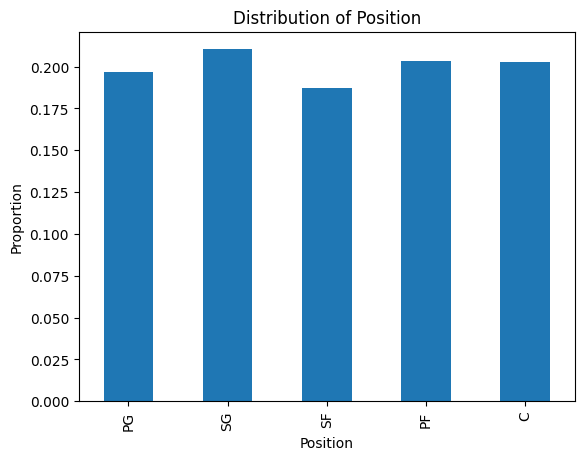

In [ ]:
df_nba["Pos"].value_counts(normalize=True).sort_index().plot.bar(xlabel = "Position",ylabel="Proportion" ,title="Distribution of Position")

This is a breakdown of the distribution of the positions in our dataset. We follow the same five positions that are used in basketball today, which are a point guard (PG), shooting guard (SG), small forward (SF), power forward (PF), and center (C). As you see, we have a pretty even spread between the five positions, which will allow us to build a good model and won't skew anything.

# The graphs below show the mean of the statistic for each position, as well as breaks down the distribution of a statistic within each position. Only done on some key and interesting statistics

<Axes: title={'center': 'Average Points Per Game For Each Position'}, xlabel='Pos', ylabel='Average Points Per Game'>

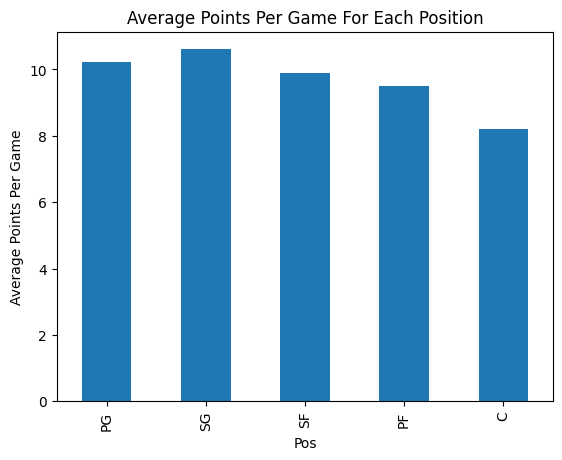

In [ ]:
df_nba.groupby("Pos")["PTS"].mean().plot.bar(ylabel = "Average Points Per Game", title = "Average Points Per Game For Each Position")

In [ ]:
alt.Chart(df_nba).mark_bar().encode(
    x=alt.X("PTS:Q", bin=alt.Bin(maxbins=10), title="Points per Game (PTS)"),
    y=alt.Y("count()"),
    color="Pos:N",
    column="Pos:N"
)

alt.Chart(...)

<Axes: title={'center': 'Average Rebounds Per Game For Each Position'}, xlabel='Pos', ylabel='Average Rebounds Per Game'>

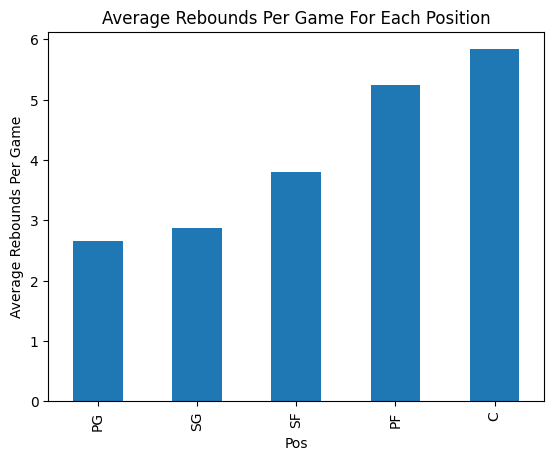

In [ ]:
df_nba.groupby("Pos")["TRB"].mean().plot.bar(ylabel = "Average Rebounds Per Game", title = "Average Rebounds Per Game For Each Position")

In [ ]:
alt.Chart(df_nba).mark_bar().encode(
    x=alt.X("TRB:Q", bin=alt.Bin(maxbins=10), title="Rebounds per Game (TRB)"),
    y=alt.Y("count()", stack=None),
    color="Pos:N",
    column="Pos:N"
)

alt.Chart(...)

<Axes: title={'center': 'Average Assists Per Game For Each Position'}, xlabel='Pos', ylabel='Average Assists Per Game'>

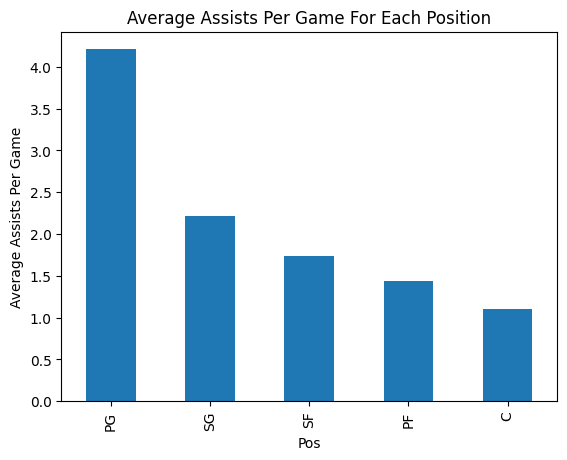

In [ ]:
df_nba.groupby("Pos")["AST"].mean().plot.bar(ylabel = "Average Assists Per Game", title = "Average Assists Per Game For Each Position")

In [ ]:
alt.Chart(df_nba).mark_bar().encode(
    x=alt.X("AST:Q", bin=alt.Bin(maxbins=10), title="Assists per Game (AST)"),
    y=alt.Y("count()", stack=None),
    color="Pos:N",
    column="Pos:N"
)

alt.Chart(...)

# Below are correlation graphs, where we investigate the correlation between some statistics within each position. The statistics I chose to explore seem to have positive association with each other

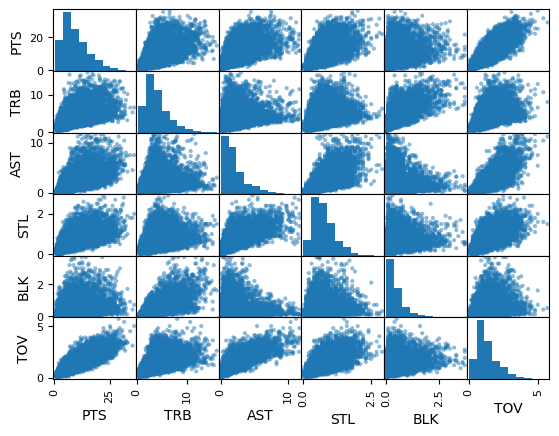

In [ ]:
pd.plotting.scatter_matrix(df_nba[["PTS", "TRB", "AST", "STL", "BLK", "TOV"]]);

In [ ]:
alt.Chart(df_nba).mark_circle().encode(
    x="PTS",
    y="TRB",
    color="Pos",
    tooltip=['Pos', "Player"],
).interactive().properties(title = "Points vs Rebounds")

alt.Chart(...)

In [ ]:
alt.Chart(df_nba).mark_circle().encode(
    x="PTS",
    y="AST",
    color="Pos",
    tooltip=['Pos', 'Player'],
).interactive().properties(title = "Points vs Assists")

alt.Chart(...)

In [ ]:
alt.Chart(df_nba).mark_circle().encode(
    x="TRB",
    y="AST",
    color="Pos",
    tooltip=['Pos', 'Player'],
).interactive().properties(title = "Rebounds vs Assists")

alt.Chart(...)

In [ ]:
alt.Chart(df_nba).mark_circle().encode(
    x="TOV",
    y="AST",
    color="Pos",
    tooltip=['Pos', 'Player'],
).interactive().properties(title = "Assists vs Turnovers")

alt.Chart(...)

In [ ]:
alt.Chart(df_nba).mark_circle().encode(
    x="TRB",
    y="BLK",
    color="Pos",
    tooltip=['Pos', 'Player'],
).interactive().properties(title = "Rebounds vs Blocks")

alt.Chart(...)

In [ ]:
alt.Chart(df_nba).mark_circle().encode(
    x="eFG%",
    y="TRB",
    color="Pos",
    tooltip=['Pos', 'Player'],
).interactive().properties(title = "Rebounds vs Blocks")

alt.Chart(...)